https://towardsdatascience.com/data-visualization-with-bokeh-in-python-part-ii-interactions-a4cf994e2512

In [14]:
#@title { display-mode: "form" }

#@markdown <b>TASK: </b> RUN this cell to set up the notebook (import packages, etc) 
# In Python, anything with a "#" in front of it is code annotation,
# and is not read by the computer.
# You can run a cell (this box) by pressing ctrl-enter or shift-enter.
# You can also run a cell by clicking the play button in the menu bar 
# at the top of the page (single right arrow, not double).
# Click in this cell and then press shift and enter simultaneously.
# This print function below allows us to generate a message.
print('Nice work!')

# No need to edit anything in this code cell
#################################
# from google.colab import files
import numpy as np
import pandas as pd
from scipy import ndimage
from scipy.signal import find_peaks
from copy import deepcopy
import math
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from pathlib import Path
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import csv
from scipy.signal import hilbert,medfilt,resample
from sklearn.decomposition import PCA
import scipy
import seaborn as sns
from ipywidgets import interactive, HBox, VBox, widgets, interact

from datetime import datetime,timezone,timedelta
pal = sns.color_palette(n_colors=15)
pal = pal.as_hex()

print('Task completed at ' + str(datetime.now(timezone(-timedelta(hours=5)))))

Nice work!
Task completed at 2022-05-04 20:43:57.278205-05:00


In [4]:
filepath = "/Users/kperks/mnt/OneDrive - wesleyan.edu/Teaching/Neurophysiology_FA21/Data/CockroachSensoryPhysiology/20211020_30k/allfeaturesonce_diffspikes_KP2021-10-20T15_18_21.bin"
number_channels = 1
sampling_rate = 30000

In [9]:

downsample = False #@param

#@markdown After you have filled out all form fields, 
#@markdown run this code cell to load the data. 

filepath = Path(filepath)

# No need to edit below this line
#################################
data = np.fromfile(Path(filepath), dtype = np.float64)
if number_channels>1:
    data = data.reshape(-1,number_channels)
dur = np.shape(data)[0]/sampling_rate
print('duration of recording was %0.2f seconds' %dur)

fs = sampling_rate
if downsample:
    newfs = 2500 #downsample emg data
    chunksize = int(sampling_rate/newfs)
    if number_channels>1:
        data = data[0::chunksize,:]
    if number_channels==1:
        data = data[0::chunksize]
    fs = int(np.shape(data)[0]/dur)

time = np.linspace(0,dur,np.shape(data)[0])

print('Now be a bit patient while it plots.')

f = go.FigureWidget(layout=go.Layout(height=500, width=800))
if number_channels == 1:
    f.add_trace(go.Scatter(x = time[0:fs], y = data[0:fs],
                             name='signal',opacity=1))
if number_channels>1:
    for i,chan in enumerate(range(number_channels)):
        f.add_trace(go.Scatter(x = time[0:fs], y = data[0:fs,chan],
                             name=str(chan),opacity=1))

slider = widgets.FloatRangeSlider(
    min=0,
    max=dur,
    value=(0,1),
    step= 1,
    readout=False,
    description='Time')
slider.layout.width = '800px'

# our function that will modify the xaxis range
def response(x):
    with f.batch_update():
        starti = int(x[0]*fs)
        stopi = int(x[1]*fs)
        
        if number_channels == 1:
            f.data[0].x = time[starti:stopi]
            f.data[0].y = data[starti:stopi]
        if number_channels > 1:
            for i in range(number_channels):
                f.data[i].x = time[starti:stopi]
                f.data[i].y = data[starti:stopi,i]

vb = VBox((f, interactive(response, x=slider)))
vb.layout.align_items = 'center'
vb


# print('Now be a bit patient while it plots.')
# fig = go.Figure()
# fig.add_trace(go.Scatter(x = time, y = data,line_color='black',name='channel 1'))
# fig.update_layout(xaxis_title="time(seconds)", yaxis_title='amplitude',width=800, height=500)
# fig.show()

duration of recording was 269.50 seconds
Now be a bit patient while it plots.


    'data': [{'name': 'signal',
              'opacity': 1,
              'type'…

List of trial times 
(either manually or using keyboard time stamps... or visually using video tracking??)

define spike threshold

ValueError: n_components=497 must be between 0 and min(n_samples, n_features)=301 with svd_solver='full'

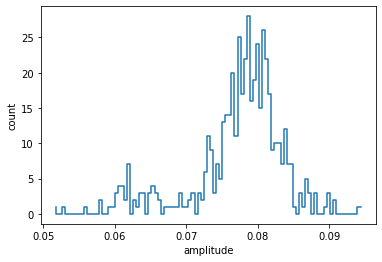

In [15]:
start_time =   43 #@param {type: "number"}
stop_time = 51  #@param {type: "number"}

threshold = 0.05  #@param {type: "number"}
#@markdown <b>TASK: </b> Then from the dropdown, select a polarity (whether peaks are up or down)
peaks = "down"  #@param ['select peak direction','up', 'down']
#@markdown <b>TASK: </b> Finally, RUN this cell to set these values.

spike_detection_threshold = threshold

if peaks=='up': polarity = 1
if peaks=='down': polarity=-1

#@markdown After the values are set, the emg signal will be processed to detect events (peaks).
#@markdown "PCA" (principle component analysis) will be applied to determine  
#@markdown the fundamental waveform shapes across all events.
#@markdown <br> You will see a histogram of event peak amplitudes 
#@markdown as well as a plot of waveform PCs (principle components).
min_isi = 0.001 #seconds

# samples_inwin = samples[int(start_time/sample_rate):int(stop_time/sample_rate)]
peaks,props = find_peaks(polarity * data,height=spike_detection_threshold, 
                         prominence = spike_detection_threshold, distance=int(min_isi*fs))
peaks_t = peaks/fs
inwin_inds = ((peaks_t>start_time) & (peaks_t<stop_time))
df_props = pd.DataFrame({
        'height': props['peak_heights'][inwin_inds],
        'spikeT' : peaks_t[inwin_inds],
        'spikeInd' : peaks[inwin_inds]
        # 'widths' : props['widths']/fs
            })
n,bins = np.histogram(df_props['height'],bins = 100) # calculate the histogram
bins = bins[1:]
hfig,ax = plt.subplots(1)
ax.step(bins,n)
ax.set_ylabel('count')
ax.set_xlabel('amplitude')

windur = 0.005
winsamp = int(windur*fs)
spkarray = []
for i in df_props['spikeInd'].values:
    spkarray.append(data[i-winsamp : i+winsamp+1])

df = pd.DataFrame(np.asarray(spkarray).T)
df_norm =(df - df.mean()) / df.std() # normalize for pca

n_components=df.shape[1] 
pca = PCA(n_components=n_components)
pca.fit(df_norm)
df_pca = pd.DataFrame(pca.transform(df), columns=['PC%i' % i for i in range(n_components)], index=df.index)
print('You detected %i events above threshold.' %len(df.columns))
#print(You have transformed this dataset into %i principle components.' %(len(df.columns),n_components))

loadings = pd.DataFrame(pca.components_.T, columns=df_pca.columns, index=df.columns)
df_data = loadings.join(df_props['height'])

hfig,ax = plt.subplots(1)
ax.set_xlabel('seconds')
ax.set_ylabel('amplitude (a.u.)')
ax.set_yticklabels([])
for c in df_pca.columns[0:5]:
    ax.plot(df_pca[c],label = c,alpha = 0.75)
plt.legend(bbox_to_anchor=(1, 1));

print('Tasks completed at ' + str(datetime.now(timezone(-timedelta(hours=5)))))

In [ ]:
def make_dataset(trial_samples_list, spike_threshold = 5):
    win = int(1*fs) #1 second window hard-coded for now
    assert np.max(trial_samples_list) < len(data)-win,
    
    data_mat = pd.DataFrame({})
    for i,t in enumerate(trial_samples_list):
        data_mat[str(i)] = data[t:t+win]
    
    # rectify and smooth to get envelope to plot
    filtert = int(0.05*fs)
    data_env = pd.DataFrame({})
    for h in list(data_mat.columns):
        y = data_mat[h] - np.mean(data_mat[h])
        y = np.abs(y)
        y = scipy.ndimage.gaussian_filter(y,filtert)
        df_env[h] = y
    
    # use find peaks to get information about each trial such as number of spikes 
    df_spikes = pd.DataFrame(columns=['number'])
    
    return data_env

In [ ]:
def make_plot(src_data_env,src_data_spikes):
    """
    src is a DataColumn source
    """
        # Blank plot with correct labels
        p = figure(plot_width = 700, plot_height = 700, 
                  title = 'Histogram of Arrival Delays by Carrier',
                  x_axis_label = 'Delay (min)', y_axis_label = 'Proportion')

        # multi line glyph to create overlay of data on each trial
        p.multi_line(source = src_data_env,line_color = 'black',line_alpha=0.75)


        # Styling
        p = style(p)

        return p 

In [ ]:
from bokeh.models.widgets import TextInput
# Create the text input element

text = TextInput(title="Enter a comma-separated list of trial start times")
text.on_change('value',update)




# Update function that accounts for all 3 controls
def update(attr, old, new):
    # get trial times from list in text input (comma separated)
    trial_times_list = text.value.strip(',')
    trial_samples_list = int(trial_times_list * fs)
    
    # Create new ColumnDataSource
    new_src = make_dataset(trial_samples_list, spike_threshold = 5)

    # Update the data on the plot
    src.data.update(new_src.data)